<a href="https://colab.research.google.com/github/santiasann/Theft-Methodology-Research/blob/main/YOLO%20Algorithm%20%26%20Model/Theft_Detection_by_YOLOv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Clone YOLOv5
%cd /content
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!git log -n 1  # check the latest commit
# Install dependencies
%pip install -qr requirements.txt

import torch
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")


/content
Cloning into 'yolov5'...
remote: Enumerating objects: 16634, done.
remote: Counting objects: 100% (175/175), done.
remote: Compressing objects: 100% (128/128), done.
remote: Total 16634 (delta 70), reused 103 (delta 47), pack-reused 16459
Receiving objects: 100% (16634/16634), 15.35 MiB | 9.27 MiB/s, done.
Resolving deltas: 100% (11373/11373), done.
/content/yolov5
commit bb27bf7868468058af4c2dccb62787d1fac8c470 (HEAD -> master, origin/master, origin/HEAD)
Author: Glenn Jocher <glenn.jocher@ultralytics.com>
Date:   Mon Jun 17 02:05:36 2024 +0200

    Update requirements.txt to `ultralytics>=8.2.34` (#13095)
    
    Update requirements.txt
    
    Signed-off-by: Glenn Jocher <glenn.jocher@ultralytics.com>
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 48.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.9/64.9 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="otmZRhz8jmqVjiY2GS8S")
project = rf.workspace("workspace-bdrph").project("theft-detection-gge4g")
version = project.version(9)
dataset = version.download("yolov5")


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 11.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 21.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 8.4 MB/s eta 0:00:00
Reason for being yanked: deprecated, use 4.8.0.76
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.10.0.82
    Uninstalling opencv-python-headless-4.10.0.82:
      Successfully uninstalled opencv-python-headless-4.10.0.82
  Attempting uninstall: idna
    Found existing installation: idna 3.7
    Uninstalling idna-3.7:
      Successfully uninstalled idna-3.7
  Attempting uninstall: cycler
    Found existing installation: cycler 0.12.1
    Uninstalling cy

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Theft-Detection-9 in yolov5pytorch:: 100%|██████████| 5208/5208 [00:01<00:00, 4325.73it/s]


In [ ]:
dataset.location

'/content/yolov5/Theft-Detection-9'

In [ ]:
%cat {dataset.location}/data.yaml

names:
- card
- crowbar
- hand
- human
- knife
- money
- object
- object-affected
- object-non affected
- pistol
- smartphone
- wallet
nc: 12
roboflow:
  license: CC BY 4.0
  project: theft-detection-gge4g
  url: https://universe.roboflow.com/workspace-bdrph/theft-detection-gge4g/dataset/9
  version: 9
  workspace: workspace-bdrph
test: ../test/images
train: Theft-Detection-9/train/images
val: Theft-Detection-9/valid/images


In [ ]:
import os
import numpy as np

# Load the images from the dataset
train_dir = '/content/yolov5/Theft-Detection-9/train/images'
test_dir = '/content/yolov5/Theft-Detection-9/test/images'
val_dir = '/content/yolov5/Theft-Detection-9/valid/images'


In [ ]:
print(os.listdir(train_dir))
print(os.listdir(test_dir))
print(os.listdir(val_dir))

['KravMagaTraining4614_jpg.rf.81cd8633a244f144ed33e54f74671fa2.jpg', 'smartphone_z3v2_02_jpg.rf.777f3f71e6fffa0c8e597a41368e4187.jpg', 'knife_1333_jpg.rf.0bff3d548869fd1a1bd05e8882d3ad1b.jpg', 'MBbframe00160_jpg.rf.090f3d3f9f947bc726a52e73b4d3309c.jpg', 'smartphone_1003_jpg.rf.a6dacd50ccb630e51c3b043d5264cbb5.jpg', 'billete_0025_jpg.rf.5b6bab8be2801b989b289513e2c8f5ab.jpg', 'DefenseKnifeAttack0423_jpg.rf.221dc870e01e5465e0db1b8f3e42aa20.jpg', '144_mp4-50_jpg.rf.f3171f6b0c34026ea43690f236d391f8.jpg', 'LBsframe00481_jpg.rf.f8f1eea176d1917d735232d7108cf9f4.jpg', 'KravMagaTraining659_jpg.rf.c3faddc79d2053b0693bb509cad3aaf6.jpg', 'KravMagaTraining20967_jpg.rf.e412fa4ae095f7b8fa3ab7e6592633fc.jpg', '102_jpeg_jpg.rf.a28e489a5512cbdf7570cb6699986a35.jpg', 'pistola_z3v6_11_jpg.rf.efc258cf58ddc8717ac52e9c45ef8b86.jpg', 'ABbframe00160_jpg.rf.22addd1205ba49819f44e43fc08857e8.jpg', 'monedero_1181_jpg.rf.685724b69c0dcdb52adb68c4a2d0be0e.jpg', '28_jpg.rf.717ad5ac70040c913004eb57df62dd08.jpg', 'yt-wWE

In [ ]:

# Get the list of files in each directory
train_files = os.listdir(train_dir)
test_files = os.listdir(test_dir)
val_files = os.listdir(val_dir)


In [ ]:
print(len(train_files))
print(len(test_files))
print(len(val_files))

2066
266
266


In [ ]:
import yaml
with open(dataset.location +"/data.yaml", 'r') as stream:
    dataset_info = yaml.safe_load(stream)
    num_classes = dataset_info['nc']
    class_names = dataset_info['names']

print(f"Number of classes: {num_classes}")
print(f"Class names: {class_names}")

Number of classes: 12
Class names: ['card', 'crowbar', 'hand', 'human', 'knife', 'money', 'object', 'object-affected', 'object-non affected', 'pistol', 'smartphone', 'wallet']


In [ ]:
%cat /content/yolov5/models/yolov5s.yaml

# Ultralytics YOLOv5 🚀, AGPL-3.0 license

# Parameters
nc: 80 # number of classes
depth_multiple: 0.33 # model depth multiple
width_multiple: 0.50 # layer channel multiple
anchors:
  - [10, 13, 16, 30, 33, 23] # P3/8
  - [30, 61, 62, 45, 59, 119] # P4/16
  - [116, 90, 156, 198, 373, 326] # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [
    [-1, 1, Conv, [64, 6, 2, 2]], # 0-P1/2
    [-1, 1, Conv, [128, 3, 2]], # 1-P2/4
    [-1, 3, C3, [128]],
    [-1, 1, Conv, [256, 3, 2]], # 3-P3/8
    [-1, 6, C3, [256]],
    [-1, 1, Conv, [512, 3, 2]], # 5-P4/16
    [-1, 9, C3, [512]],
    [-1, 1, Conv, [1024, 3, 2]], # 7-P5/32
    [-1, 3, C3, [1024]],
    [-1, 1, SPPF, [1024, 5]], # 9
  ]

# YOLOv5 v6.0 head
head: [
    [-1, 1, Conv, [512, 1, 1]],
    [-1, 1, nn.Upsample, [None, 2, "nearest"]],
    [[-1, 6], 1, Concat, [1]], # cat backbone P4
    [-1, 3, C3, [512, False]], # 13

    [-1, 1, Conv, [256, 1, 1]],
    [-1, 1, nn.Upsample, [None, 2, "nearest"]],
    [[-1, 4],

In [ ]:
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
  with open(line, 'w') as f:
    f.write(cell.format(**globals()))

In [ ]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml
# Parameters
nc: 80 # number of classes
depth_multiple: 0.33 # model depth multiple
width_multiple: 0.50 # layer channel multiple
anchors:
  - [10, 13, 16, 30, 33, 23] # P3/8
  - [30, 61, 62, 45, 59, 119] # P4/16
  - [116, 90, 156, 198, 373, 326] # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [
    [-1, 1, Conv, [64, 6, 2, 2]], # 0-P1/2
    [-1, 1, Conv, [128, 3, 2]], # 1-P2/4
    [-1, 3, C3, [128]],
    [-1, 1, Conv, [256, 3, 2]], # 3-P3/8
    [-1, 6, C3, [256]],
    [-1, 1, Conv, [512, 3, 2]], # 5-P4/16
    [-1, 9, C3, [512]],
    [-1, 1, Conv, [1024, 3, 2]], # 7-P5/32
    [-1, 3, C3, [1024]],
    [-1, 1, SPPF, [1024, 5]], # 9
  ]

# YOLOv5 v6.0 head
head: [
    [-1, 1, Conv, [512, 1, 1]],
    [-1, 1, nn.Upsample, [None, 2, "nearest"]],
    [[-1, 6], 1, Concat, [1]], # cat backbone P4
    [-1, 3, C3, [512, False]], # 13

    [-1, 1, Conv, [256, 1, 1]],
    [-1, 1, nn.Upsample, [None, 2, "nearest"]],
    [[-1, 4], 1, Concat, [1]], # cat backbone P3
    [-1, 3, C3, [256, False]], # 17 (P3/8-small)

    [-1, 1, Conv, [256, 3, 2]],
    [[-1, 14], 1, Concat, [1]], # cat head P4
    [-1, 3, C3, [512, False]], # 20 (P4/16-medium)

    [-1, 1, Conv, [512, 3, 2]],
    [[-1, 10], 1, Concat, [1]], # cat head P5
    [-1, 3, C3, [1024, False]], # 23 (P5/32-large)

    [[17, 20, 23], 1, Detect, [nc, anchors]], # Detect(P3, P4, P5)
  ]

In [ ]:
!python train.py --img 416 --batch 16 --epoch 50 --data {dataset.location}/data.yaml --cfg ./models/custom_yolov5s.yaml --weights yolov5s.pt --name yolov5s_results --cache

2024-06-18 13:06:54.042985: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-18 13:06:54.043037: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-18 13:06:54.149775: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=./models/custom_yolov5s.yaml, data=/content/yolov5/Theft-Detection-9/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=ram, image_weigh

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs/train

<IPython.core.display.Javascript object>

In [ ]:
from IPython.display import Image, display

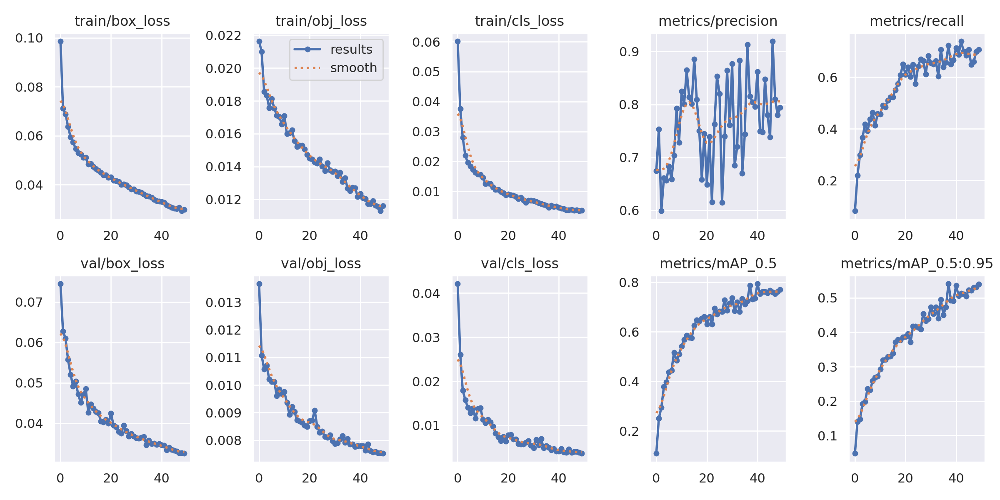

In [ ]:
from utils.plots import plot_results
Image(filename='/content/yolov5/runs/train/yolov5s_results/results.png', width=1000)

Ground truth training data:


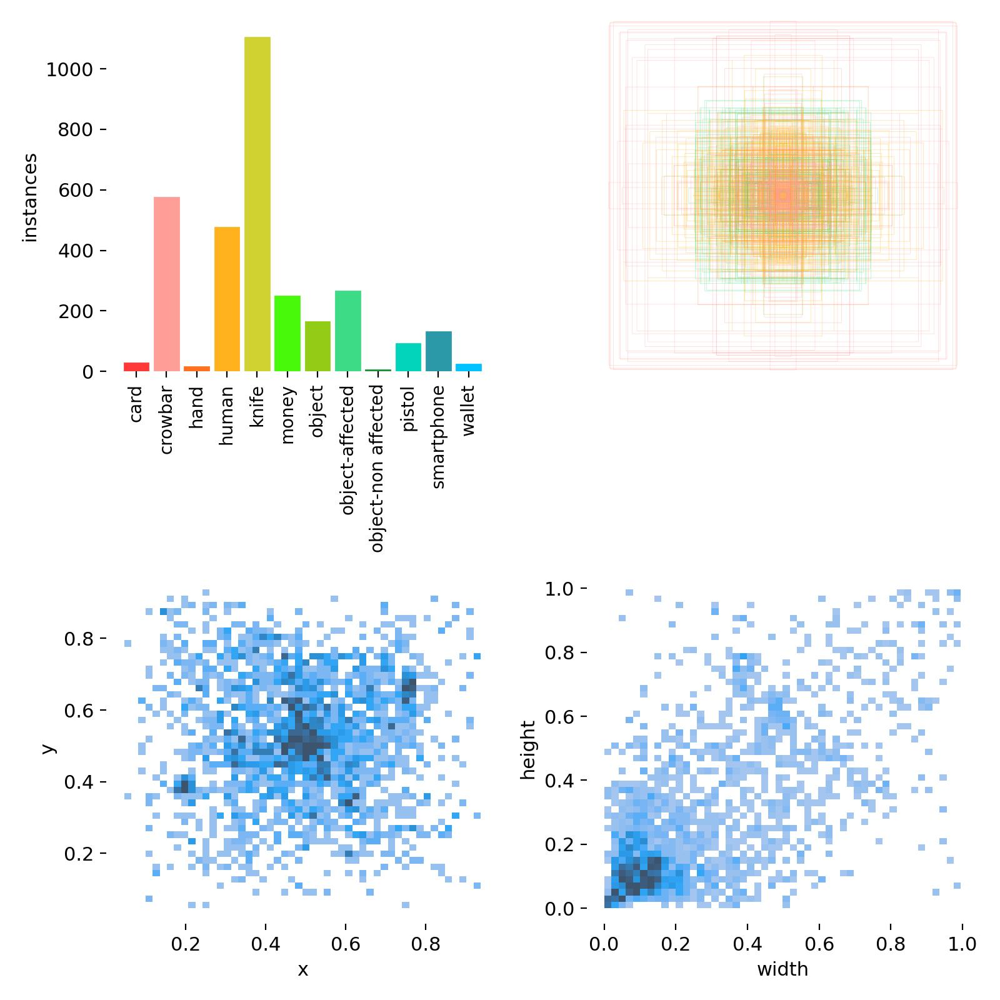

In [ ]:
print("Ground truth training data:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/labels.jpg', width=900)

Ground truth training data:


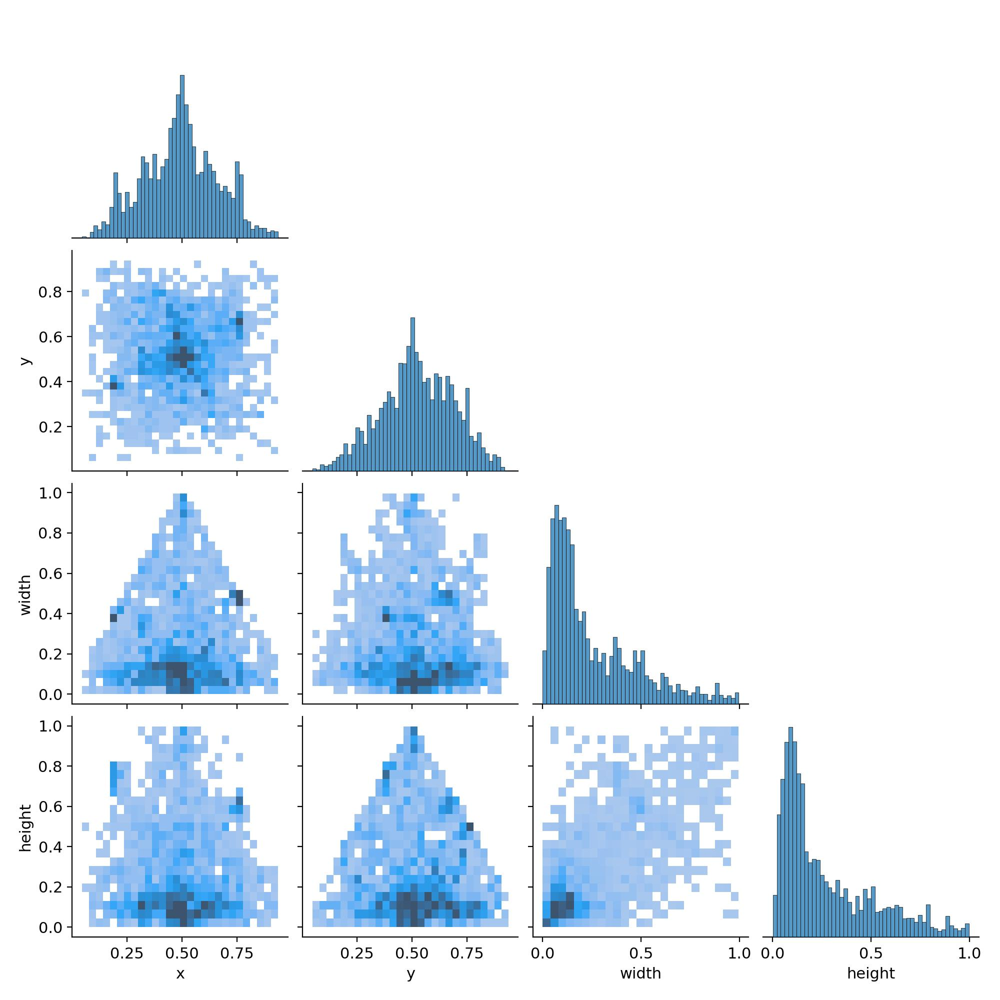

In [ ]:
print("Ground truth training data:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/labels_correlogram.jpg', width=900)

Ground truth training data:


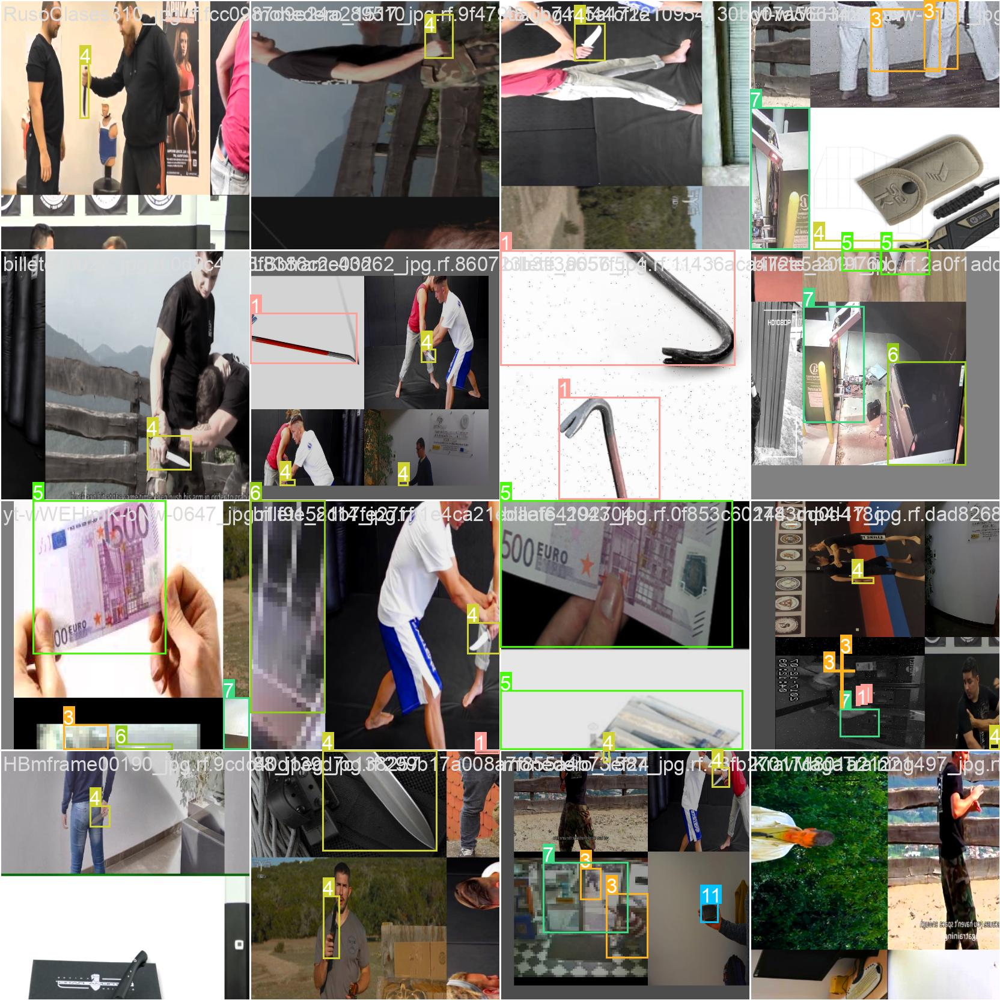

In [ ]:
print("Ground truth training data:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/train_batch0.jpg', width=900)

In [ ]:
%ls runs/

train/


In [ ]:
%ls runs/train/yolov5s_results/weights

best.pt  last.pt


In [ ]:
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 640 --conf 0.4 --source /content/yolov5/Theft-Detection-9/test/images

detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=/content/yolov5/Theft-Detection-9/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-324-gbb27bf78 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7042489 parameters, 0 gradients, 15.9 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/266 /content/yolov5/Theft-Detection-9/test/images/102_jpeg_jpg.rf.0cea3d555babe69134c472faa3831b34.jpg: 640x640 1 object-affected, 11.6ms
image 2/266 /content/yolov5/Theft-Detection-9/test/images/111_jpeg_jpg.rf.b35c9ebbccc8d6d05d1e5

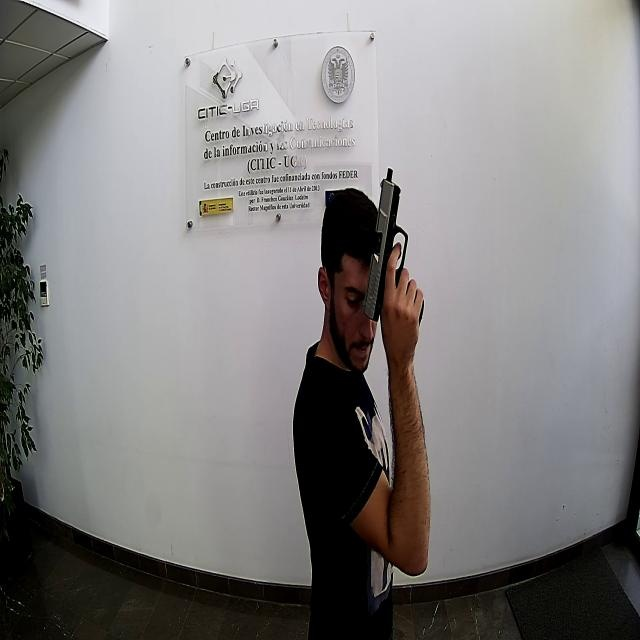

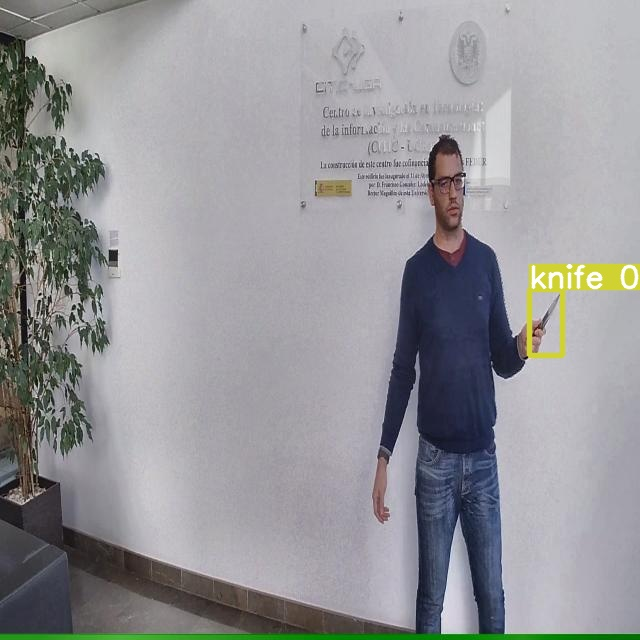

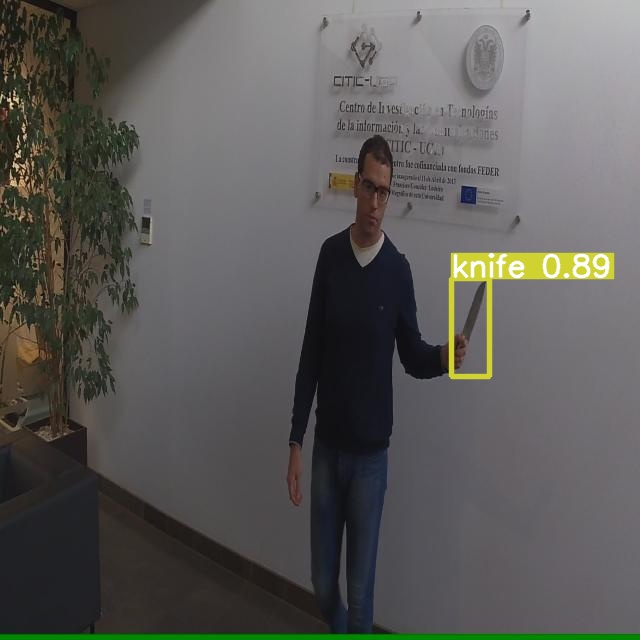

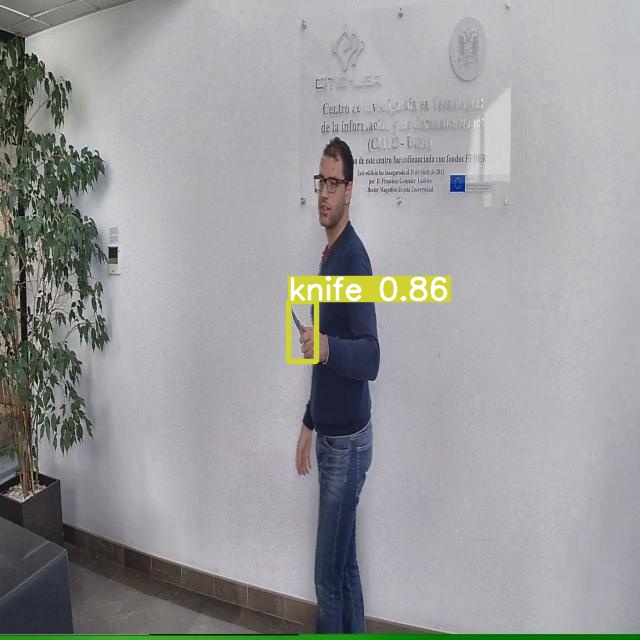

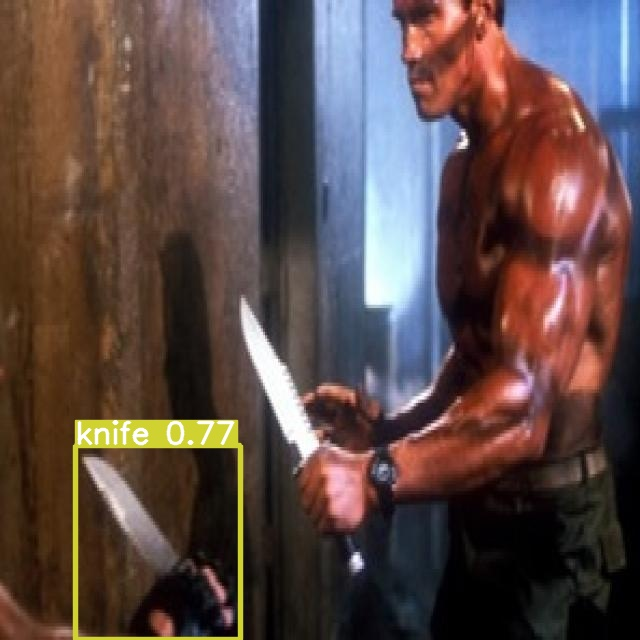

...

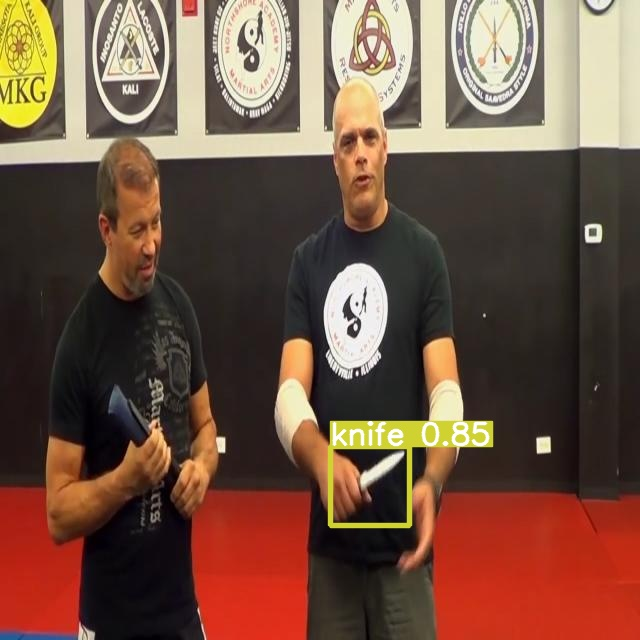

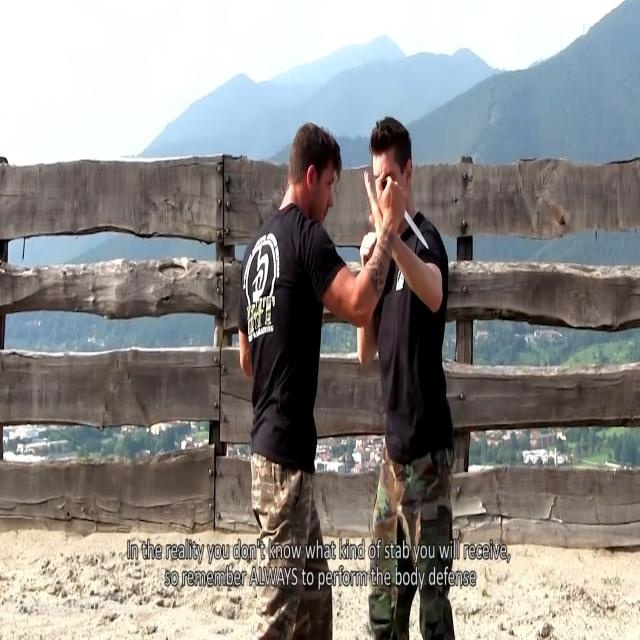

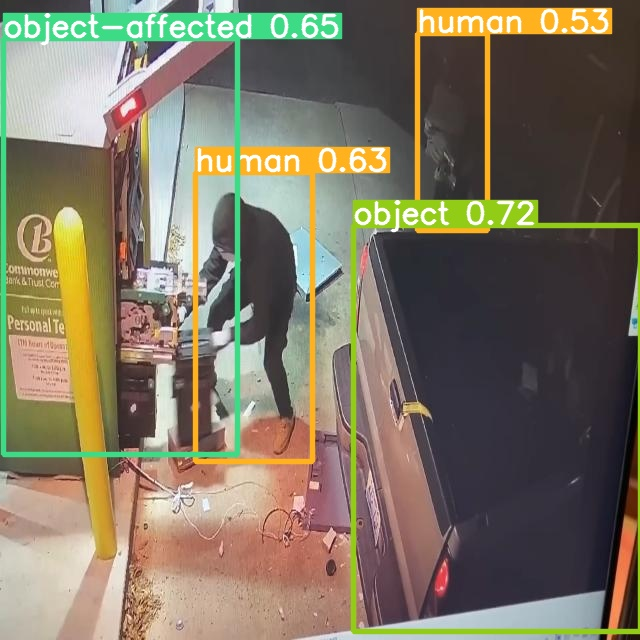

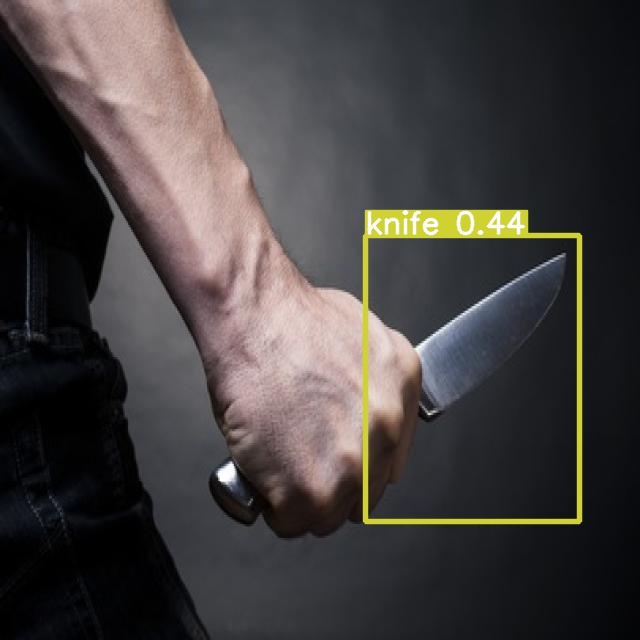

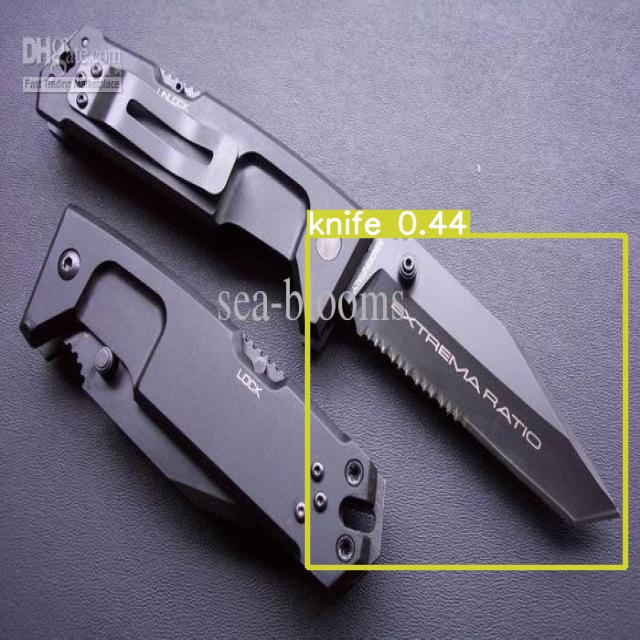

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp//*jpg'):
  display(Image(filename=imageName))
  print("\n")

In [ ]:
#export your model's weights for future use
from google.colab import files
files.download('./runs/train/yolov5s_results/weights/best.pt')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>